In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import zipfile

zip_ref = zipfile.ZipFile("/content/drive/MyDrive/8Flowers.zip", 'r')
zip_ref.extractall("/content")
zip_ref.close()

In [ ]:
!pip install mahotas

     |████████████████████████████████| 5.7 MB 5.4 MB/s 


In [ ]:
# GLOBAL FEATURE EXTRACTION
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
import numpy as np
import mahotas
import cv2
import os
import h5py

# tunable-parameters
images_per_class = 75
fixed_size       = tuple((500, 500))
train_path       = "dataset/train"
h5_data          = 'output/data.h5'
h5_labels        = 'output/labels.h5'
bins             = 8

DEFINATION OF FEATURE EXTRACTORS

In [ ]:
# FEATURE_DESCRIPTOR_1: Hu Moments
def fd_hu_moments(image):
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    feature = cv2.HuMoments(cv2.moments(image)).flatten()
    return feature

In [ ]:
# FEATURE_DESCRIPTOR_2: Haralick Texture
def fd_haralick(image):
    # image is converyed to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # haralick texture feature vector is computed
    haralick = mahotas.features.haralick(gray).mean(axis=0)
    # return the result
    return haralick

In [ ]:
# FEATURE_DESCRIPTOR_3: Color Histogram
def fd_histogram(image, mask=None):
    # convert the image to HSV color-space
    image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    # compute the color histogram
    hist  = cv2.calcHist([image], [0, 1, 2], None, [bins, bins, bins], [0, 256, 0, 256, 0, 256])
    # normalize the histogram
    cv2.normalize(hist, hist)
    # return the histogram
    return hist.flatten()

In [ ]:
# getting training labels
train_labels = os.listdir(train_path)

# sorting training labels
train_labels.sort()
print(train_labels)

# lists to store feature vectors and labels
global_features = []
labels          = []

['ColisFoot', 'Daffodil', 'Daisy', 'Dandelion', 'Fritillary', 'Snowdrop', 'Sunflower', 'Tigerlily']


In [ ]:
!pip install -U numpy

     |████████████████████████████████| 15.7 MB 60 kB/s 
  Attempting uninstall: numpy
    Found existing installation: numpy 1.19.5
    Uninstalling numpy-1.19.5:
      Successfully uninstalled numpy-1.19.5
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
yellowbrick 1.3.post1 requires numpy<1.20,>=1.16.0, but you have numpy 1.21.4 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


In [ ]:
import mahotas.features

In [ ]:
# loop over the training data sub-folders
for training_name in train_labels:
    # join the training data path and each species training folder
    dir = os.path.join(train_path, training_name)

    # get the current training label
    current_label = training_name

    # loop over the images in each sub-folder
    for x in range(1,images_per_class+1):
        # get the image file name
        file = dir + "/" + str(x) + ".jpg"

        # read the image and resize it to a fixed-size
        image = cv2.imread(file)
        image = cv2.resize(image, fixed_size)

        # Global Feature extraction
        fv_hu_moments = fd_hu_moments(image)
        fv_haralick   = fd_haralick(image)
        fv_histogram  = fd_histogram(image)

        # Concatenate global features
        global_feature = np.hstack([fv_histogram, fv_haralick, fv_hu_moments])

        # update the list of labels and feature vectors
        labels.append(current_label)
        global_features.append(global_feature)

    print("processed folder: {}".format(current_label))

print("completed Global Feature Extraction...")

processed folder: ColisFoot
processed folder: Daffodil
processed folder: Daisy
processed folder: Dandelion
processed folder: Fritillary
processed folder: Snowdrop
processed folder: Sunflower
processed folder: Tigerlily
completed Global Feature Extraction...


In [ ]:
# get the overall feature vector size
print("feature vector size {}".format(np.array(global_features).shape))

# get the overall training label size
print("training Labels {}".format(np.array(labels).shape))

# encode the target labels
targetNames = np.unique(labels)
le          = LabelEncoder()
target      = le.fit_transform(labels)
print("training labels encoded...")

# scale features in the range (0-1)
scaler            = MinMaxScaler(feature_range=(0, 1))
rescaled_features = scaler.fit_transform(global_features)
print("feature vector normalized...")

print("target labels: {}".format(target))
print("target labels shape: {}".format(target.shape))

# save the feature vector using HDF5
h5f_data = h5py.File(h5_data, 'w')
h5f_data.create_dataset('dataset_1', data=np.array(rescaled_features))

h5f_label = h5py.File(h5_labels, 'w')
h5f_label.create_dataset('dataset_1', data=np.array(target))

h5f_data.close()
h5f_label.close()

feature vector size (600, 532)
training Labels (600,)
training labels encoded...
feature vector normalized...
target labels: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4
 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4
 4 4 4 4 4 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5
 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5

In [ ]:
import h5py
import numpy as np
import os
import glob
import cv2
import warnings
from matplotlib import pyplot
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.model_selection import KFold
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier

warnings.filterwarnings('ignore')

# tunable-parameters

test_size = 0.1
seed      = 9
train_path = "dataset/train"
test_path  = "dataset/test"
h5_data    = 'output/data.h5'
h5_labels  = 'output/labels.h5'
scoring    = "accuracy"

# geting training labels
train_labels = os.listdir(train_path)

# sorting training labels
train_labels.sort()

if not os.path.exists(test_path):
    os.makedirs(test_path)

# create all the machine learning models
models = []
models.append(('LR', LogisticRegression(random_state=seed)))
models.append(('MLP', MLPClassifier(solver = 'sgd', random_state = seed,  max_iter=3000)))

# variables storing results and names
results = []
names   = []

# importing feature vector and trained labels
h5f_data  = h5py.File(h5_data, 'r')
h5f_label = h5py.File(h5_labels, 'r')

global_features_string = h5f_data['dataset_1']
global_labels_string   = h5f_label['dataset_1']

global_features = np.array(global_features_string)
global_labels   = np.array(global_labels_string)

h5f_data.close()
h5f_label.close()

# verify the shape of the feature vector and labels
print("features shape: {}".format(global_features.shape))
print("labels shape: {}".format(global_labels.shape))

print("training started...")

features shape: (600, 532)
labels shape: (600,)
training started...


In [ ]:
# split the training and testing data
(trainDataGlobal, testDataGlobal, trainLabelsGlobal, testLabelsGlobal) = train_test_split(np.array(global_features),
                                                                                          np.array(global_labels),
                                                                                          test_size=test_size,
                                                                                          random_state=seed)

print("train and test data splitted...")
print("Train data  : {}".format(trainDataGlobal.shape))
print("Test data   : {}".format(testDataGlobal.shape))
print("Train labels: {}".format(trainLabelsGlobal.shape))
print("Test labels : {}".format(testLabelsGlobal.shape))

train and test data splitted...
Train data  : (540, 532)
Test data   : (60, 532)
Train labels: (540,)
Test labels : (60,)


K-fold and cross_validation score to get the best model

[0.66666667 0.66666667 0.64814815 0.61111111 0.74074074 0.57407407
 0.7037037  0.62962963 0.87037037 0.74074074]
LR: 0.685185 (0.079866)
[0.72222222 0.77777778 0.61111111 0.62962963 0.72222222 0.66666667
 0.75925926 0.64814815 0.85185185 0.77777778]
MLP: 0.716667 (0.073166)


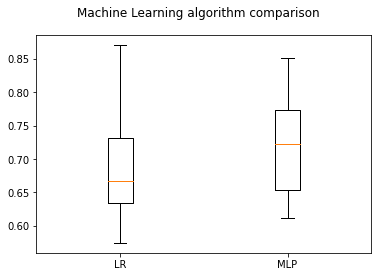

In [ ]:
# 10-fold cross validation
for name, model in models:
    kfold = KFold(n_splits=10)
    cv_results = cross_val_score(model, trainDataGlobal, trainLabelsGlobal, cv=kfold, scoring=scoring)
    print(cv_results)
    results.append(cv_results)
    names.append(name)
    msg = "%s: %f (%f)" % (name, cv_results.mean(), cv_results.std())
    print(msg)

# boxplot and compairision
fig = pyplot.figure()
fig.suptitle('Machine Learning algorithm comparison')
ax = fig.add_subplot(111)
pyplot.boxplot(results)
ax.set_xticklabels(names)
pyplot.show()

Spiting the global data features again into train, test and validation set to train the best models

In [ ]:
# split the training and testing data
(trainDataGlobal, testDataGlobal, trainLabelsGlobal, testLabelsGlobal) = train_test_split(np.array(global_features),
                                                                                          np.array(global_labels),
                                                                                          test_size=test_size,
                                                                                          random_state=seed)

(trainDataGlobal, valDataGlobal, trainLabelsGlobal, valLabelsGlobal) = train_test_split(np.array(trainDataGlobal),
                                                                                          np.array(trainLabelsGlobal),
                                                                                          test_size=0.1,
                                                                                          random_state=seed)
print("train and test data are splitted...")
print("Train data  : {}".format(trainDataGlobal.shape))
print("Test data   : {}".format(testDataGlobal.shape))
print("Val data   : {}".format(testDataGlobal.shape))
print("Train labels: {}".format(trainLabelsGlobal.shape))
print("Test labels : {}".format(testLabelsGlobal.shape))
print("Val labels : {}".format(testLabelsGlobal.shape))

train and test data are splitted...
Train data  : (486, 532)
Test data   : (60, 532)
Val data   : (60, 532)
Train labels: (486,)
Test labels : (60,)
Val labels : (60,)


**1. LOGISTIC REGRESSION**

Hyperparameter tunning(using the train and validation set)

In [ ]:
from sklearn import metrics

lr_class_weight = [None, 'balanced']
lr_max_iters = [1, 10, 100, 200]
lr_tolerance = [0.0001, 0.0002]
optimized_model_lr = LogisticRegression(random_state=seed)
acc = -1
for w in lr_class_weight:
  for iter in lr_max_iters:
    for rho in lr_tolerance:
      model1 = LogisticRegression(random_state=seed, class_weight=(w), max_iter=int(iter), tol=(rho))
      model1.fit(trainDataGlobal, np.array(trainLabelsGlobal))
      y_pred_val = model1.predict(valDataGlobal)
      if metrics.accuracy_score(valLabelsGlobal, y_pred_val) > acc:
        acc = metrics.accuracy_score(valLabelsGlobal, y_pred_val)
        optimized_model_lr = model1
print(optimized_model_lr)
print(optimized_model_lr.get_params())

LogisticRegression(random_state=9)
{'C': 1.0, 'class_weight': None, 'dual': False, 'fit_intercept': True, 'intercept_scaling': 1, 'l1_ratio': None, 'max_iter': 100, 'multi_class': 'auto', 'n_jobs': None, 'penalty': 'l2', 'random_state': 9, 'solver': 'lbfgs', 'tol': 0.0001, 'verbose': 0, 'warm_start': False}


Traning and testing the model with the best set of hyperparameters

In [ ]:
# import matplotlib.pyplot as plt

from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

# used the optimised logistic regression model obtained in the previous cell
clf  = optimized_model_lr

# fit the training data to the model
clf.fit(trainDataGlobal, trainLabelsGlobal)

predictions =  clf.predict(testDataGlobal)  
print(len(predictions))

# score
print("score: ", clf.score(testDataGlobal, testLabelsGlobal))
print("Report: \n", classification_report(testLabelsGlobal, predictions))
print("Confision matrix: \n ", confusion_matrix(testLabelsGlobal, predictions))

print("\n")
predict_index = 0
for a in range((len(predictions))):
   print("original label: ", testLabelsGlobal[a]," and " ,"predicted label: ", predictions[a])

60
score:  0.65
Report: 
               precision    recall  f1-score   support

           0       0.78      0.58      0.67        12
           1       0.71      0.71      0.71         7
           2       0.57      0.57      0.57         7
           3       0.44      0.67      0.53         6
           4       0.83      1.00      0.91         5
           5       0.70      1.00      0.82         7
           6       0.33      0.40      0.36         5
           7       0.83      0.45      0.59        11

    accuracy                           0.65        60
   macro avg       0.65      0.67      0.65        60
weighted avg       0.68      0.65      0.65        60

Confision matrix: 
  [[7 0 1 2 1 0 1 0]
 [0 5 0 1 0 0 1 0]
 [0 0 4 0 0 3 0 0]
 [0 1 0 4 0 0 1 0]
 [0 0 0 0 5 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 0 1 1 0 0 2 1]
 [2 1 1 1 0 0 1 5]]


original label:  7  and  predicted label:  7
original label:  2  and  predicted label:  2
original label:  0  and  predicted label:  2
original lab

Testing the model on some random images to get a better view of predicted output

40


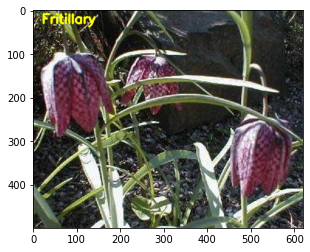

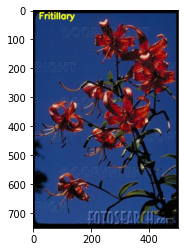

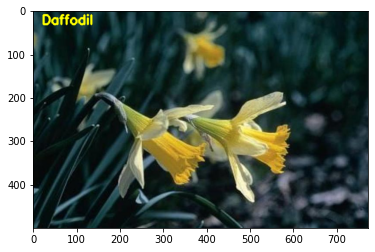

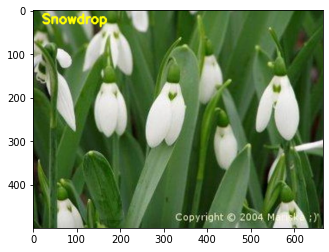

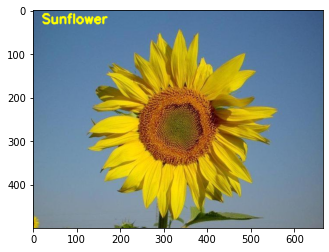

...

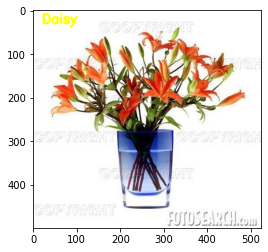

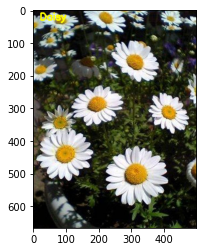

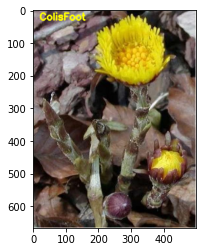

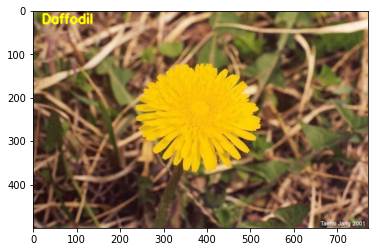

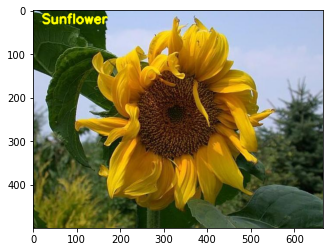

In [ ]:
import matplotlib.pyplot as plt

# using the logistic regression with the best set of hyperparameters
clf  = optimized_model_lr

# fit the training data to the model
clf.fit(trainDataGlobal, trainLabelsGlobal)
global_test_features = []

test_images_paths = glob.glob(test_path + "/*.jpg")
# loop through the test images
for file in test_images_paths:
    # read the image
    image = cv2.imread(file)

    # resize the image
    image = cv2.resize(image, fixed_size)

    # Global Feature extraction
    fv_hu_moments = fd_hu_moments(image)
    fv_haralick   = fd_haralick(image)
    fv_histogram  = fd_histogram(image)

    # Concatenate global features
    global_feature = np.hstack([fv_histogram, fv_haralick, fv_hu_moments])
    global_test_features.append(global_feature)
    
# scaling features in the range (0 to 1)  
scaler = MinMaxScaler(feature_range=(0, 1))
rescaled_features = scaler.fit_transform(global_test_features)

# predict label of test image
predictions =  clf.predict(rescaled_features)  
print(len(predictions))

predict_index = 0
i = 0

for file in test_images_paths:
    image = cv2.imread(file)
    # show predicted label on image
    cv2.putText(image, train_labels[predictions[predict_index]], (20,30), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0,255,255), 3)

    # show output image
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.show()
    predict_index += 1

**2. MULTILAYER PERCEPTRON**

Hyperparameter tunning(using the train and validation set)

In [ ]:
mlp_max_iters = [200, 225, 200, 250]
mlp_learning_rate = [0.001, 0.01, 0.07, 0.1]
mlp_tolerance = [0.0001, 0.0002, 0.0003, 0.0004]
optimized_model_mlp = MLPClassifier(solver='sgd', hidden_layer_sizes=(100), activation='logistic', random_state=2)
acc = -1
for iter in mlp_max_iters:
  for lr in mlp_learning_rate:
    for rho in mlp_tolerance:
      model3 = MLPClassifier(solver='sgd', hidden_layer_sizes=(100), activation='logistic', random_state=2, learning_rate_init=(lr), tol=(rho), max_iter=int(iter))
      model3.fit(trainDataGlobal, np.array(trainLabelsGlobal))
      mlp_y_pred_val = model3.predict(valDataGlobal)
      if metrics.accuracy_score(valLabelsGlobal, mlp_y_pred_val) > acc:
        acc = metrics.accuracy_score(valLabelsGlobal, mlp_y_pred_val)
        optimized_model_mlp = model3
optimized_model_mlp

MLPClassifier(activation='logistic', hidden_layer_sizes=100,
              learning_rate_init=0.1, random_state=2, solver='sgd')

Traning and testing the model with the best set of hyperparameters

In [ ]:
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix


# using the mlp model with best set of hyperparameters
clf  = optimized_model_mlp

# fit the training data to the model
clf.fit(trainDataGlobal, trainLabelsGlobal)

predictions =  clf.predict(testDataGlobal)  
print(len(predictions))

# score
print("score: ", clf.score(testDataGlobal, testLabelsGlobal))
print("Report: \n", classification_report(testLabelsGlobal, predictions))
print("Confision matrix: \n ", confusion_matrix(testLabelsGlobal, predictions))

predict_index = 0
for a in range((len(predictions))):
   print("original label: ", testLabelsGlobal[a]," and " ,"predicted label: ", predictions[a])

60
score:  0.6666666666666666
Report: 
               precision    recall  f1-score   support

           0       0.67      0.67      0.67        12
           1       0.60      0.43      0.50         7
           2       0.83      0.71      0.77         7
           3       0.44      0.67      0.53         6
           4       0.83      1.00      0.91         5
           5       0.78      1.00      0.88         7
           6       0.33      0.40      0.36         5
           7       0.86      0.55      0.67        11

    accuracy                           0.67        60
   macro avg       0.67      0.68      0.66        60
weighted avg       0.69      0.67      0.67        60

Confision matrix: 
  [[8 0 0 2 1 0 1 0]
 [2 3 0 1 0 0 1 0]
 [0 0 5 0 0 2 0 0]
 [0 1 0 4 0 0 1 0]
 [0 0 0 0 5 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 1 0 1 0 0 2 1]
 [2 0 1 1 0 0 1 6]]
original label:  7  and  predicted label:  7
original label:  2  and  predicted label:  2
original label:  0  and  predicted label:  0


Testing the model on some random images to get a better view of predicted output

40


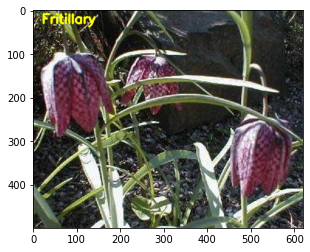

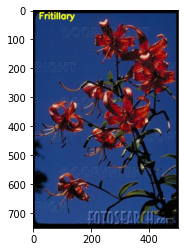

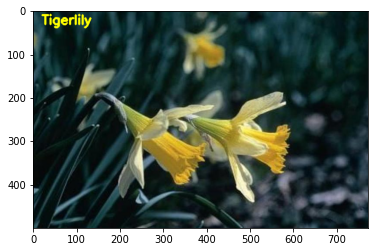

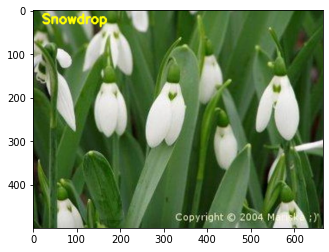

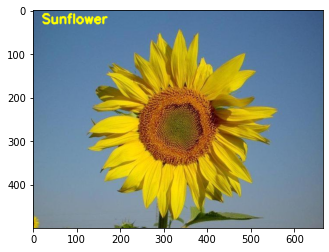

...

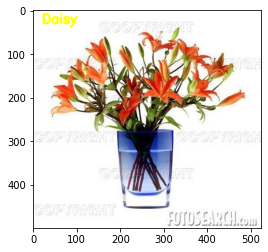

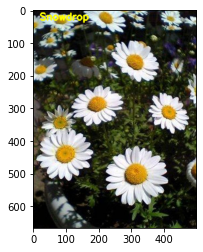

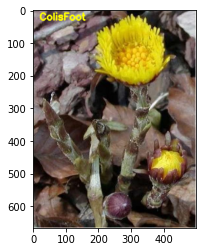

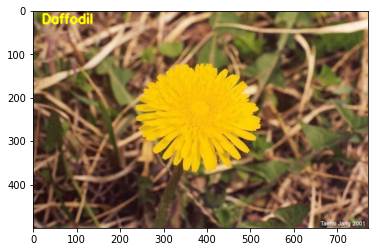

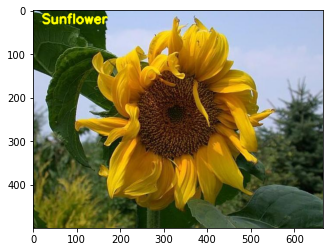

In [ ]:
import matplotlib.pyplot as plt

# using the mlp model with best set of hyperparameters
clf  = optimized_model_mlp

# fit the training data to the model
clf.fit(trainDataGlobal, trainLabelsGlobal)
global_test_features = []

test_images_paths = glob.glob(test_path + "/*.jpg")
# loop through the test images
for file in test_images_paths:
    # read the image
    image = cv2.imread(file)

    # resize the image
    image = cv2.resize(image, fixed_size)

    # Global Feature extraction
    fv_hu_moments = fd_hu_moments(image)
    fv_haralick   = fd_haralick(image)
    fv_histogram  = fd_histogram(image)

    # Concatenate global features
    global_feature = np.hstack([fv_histogram, fv_haralick, fv_hu_moments])
    global_test_features.append(global_feature)
    
# scaling features in the rangce (0 to 1)  
scaler = MinMaxScaler(feature_range=(0, 1))
rescaled_features = scaler.fit_transform(global_test_features)

# predicting label of test image
predictions =  clf.predict(rescaled_features)  
print(len(predictions))

predict_index = 0
i = 0

for file in test_images_paths:
    image = cv2.imread(file)
    # show predicted label on image
    cv2.putText(image, train_labels[predictions[predict_index]], (20,30), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0,255,255), 3)

    # show the output image
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.show()
    predict_index += 1

**Training without using hyperparameter tuning**

In [ ]:
# import matplotlib.pyplot as plt

from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix


# create the model - Logistic regression
clf  = LogisticRegression(random_state=seed)

# fit the training data to the model
clf.fit(trainDataGlobal, trainLabelsGlobal)
# global_test_features = []

predictions =  clf.predict(testDataGlobal)  
print(len(predictions))

# score
print("score: ", clf.score(testDataGlobal, testLabelsGlobal))
print("Report: \n", classification_report(testLabelsGlobal, predictions))
print("Confision matrix: \n ", confusion_matrix(testLabelsGlobal, predictions))

predict_index = 0
for a in range((len(predictions))):
   print("original: ", testLabelsGlobal[a], "predicted: ", predictions[a])\

# print("clf: \n", clf)   

60
score:  0.7166666666666667
Report: 
               precision    recall  f1-score   support

           0       0.82      0.75      0.78        12
           1       0.83      0.71      0.77         7
           2       0.71      0.71      0.71         7
           3       0.44      0.67      0.53         6
           4       0.83      1.00      0.91         5
           5       0.78      1.00      0.88         7
           6       0.40      0.40      0.40         5
           7       0.86      0.55      0.67        11

    accuracy                           0.72        60
   macro avg       0.71      0.72      0.71        60
weighted avg       0.74      0.72      0.72        60

Confision matrix: 
  [[9 0 0 2 1 0 0 0]
 [0 5 0 1 0 0 1 0]
 [0 0 5 0 0 2 0 0]
 [0 1 0 4 0 0 1 0]
 [0 0 0 0 5 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 0 1 1 0 0 2 1]
 [2 0 1 1 0 0 1 6]]
original:  7 predicted:  7
original:  2 predicted:  2
original:  0 predicted:  0
original:  1 predicted:  1
original:  7 predicted:  6


In [ ]:
### Testing the data for the test set from train_test_split
# import matplotlib.pyplot as plt

from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix


# create the model - MLP
clf  = MLPClassifier(solver = 'sgd', random_state = seed,  max_iter=3000)

# fit the training data to the model
clf.fit(trainDataGlobal, trainLabelsGlobal)
# global_test_features = []

predictions =  clf.predict(testDataGlobal)  
print(len(predictions))

# score
print("score: ", clf.score(testDataGlobal, testLabelsGlobal))
print("Report: \n", classification_report(testLabelsGlobal, predictions))
print("Confision matrix: \n ", confusion_matrix(testLabelsGlobal, predictions))

predict_index = 0
for a in range((len(predictions))):
   print("original: ", testLabelsGlobal[a], "predicted: ", predictions[a])

60
score:  0.6833333333333333
Report: 
               precision    recall  f1-score   support

           0       0.75      0.75      0.75        12
           1       0.60      0.43      0.50         7
           2       0.83      0.71      0.77         7
           3       0.50      0.67      0.57         6
           4       0.83      1.00      0.91         5
           5       0.70      1.00      0.82         7
           6       0.33      0.40      0.36         5
           7       0.86      0.55      0.67        11

    accuracy                           0.68        60
   macro avg       0.68      0.69      0.67        60
weighted avg       0.70      0.68      0.68        60

Confision matrix: 
  [[9 0 0 1 1 0 1 0]
 [1 3 0 1 0 1 1 0]
 [0 0 5 0 0 2 0 0]
 [0 1 0 4 0 0 1 0]
 [0 0 0 0 5 0 0 0]
 [0 0 0 0 0 7 0 0]
 [0 1 0 1 0 0 2 1]
 [2 0 1 1 0 0 1 6]]
original:  7 predicted:  7
original:  2 predicted:  2
original:  0 predicted:  0
original:  1 predicted:  5
original:  7 predicted:  6


Testing on some random images

40


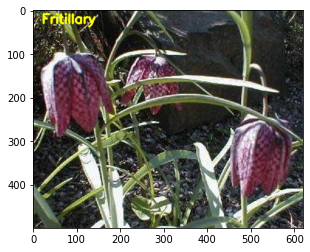

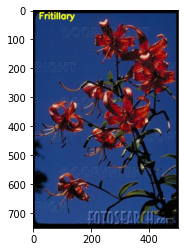

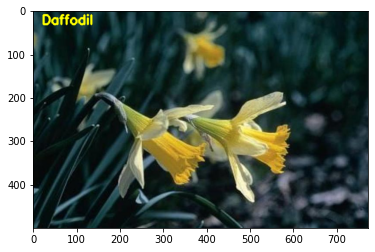

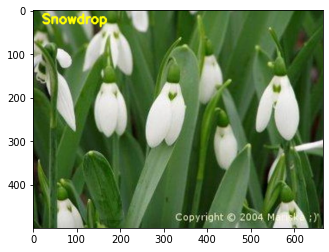

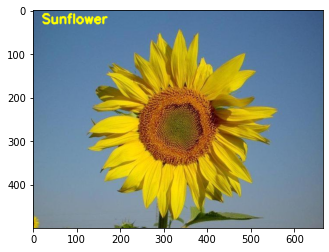

...

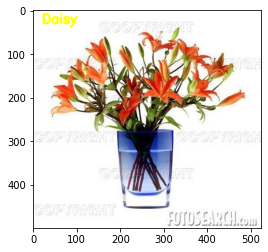

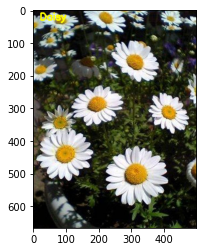

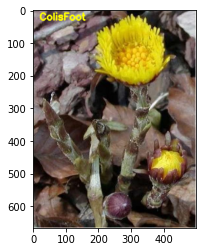

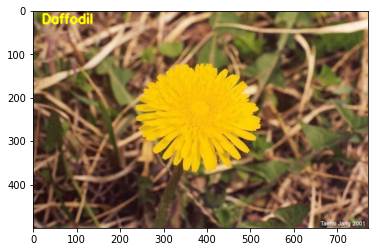

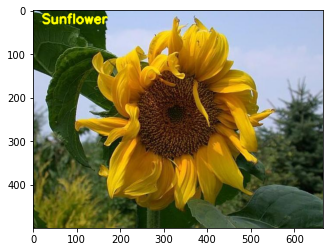

In [ ]:
### Testing the data for some random sample images 
import matplotlib.pyplot as plt

# create the model - Logistic Regression
clf  = LogisticRegression(random_state=seed)

# fit the training data to the model
clf.fit(trainDataGlobal, trainLabelsGlobal)
global_test_features = []

test_images_paths = glob.glob(test_path + "/*.jpg")
# loop through the test images
for file in test_images_paths:
    # read the image
    image = cv2.imread(file)

    # resize the image
    image = cv2.resize(image, fixed_size)

    # Global Feature extraction
    fv_hu_moments = fd_hu_moments(image)
    fv_haralick   = fd_haralick(image)
    fv_histogram  = fd_histogram(image)

    # Concatenate global features
    global_feature = np.hstack([fv_histogram, fv_haralick, fv_hu_moments])
    global_test_features.append(global_feature)
    
# scale features in the rangce (0 to 1)  
scaler = MinMaxScaler(feature_range=(0, 1))
rescaled_features = scaler.fit_transform(global_test_features)

# predict label of test image
predictions =  clf.predict(rescaled_features)  
print(len(predictions))

predict_index = 0
i = 0

for file in test_images_paths:
    image = cv2.imread(file)
    # show predicted label on image
    cv2.putText(image, train_labels[predictions[predict_index]], (20,30), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0,255,255), 3)

    # display the output image
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.show()
    predict_index += 1

40


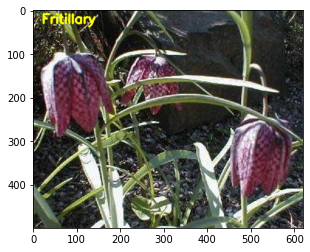

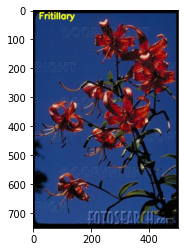

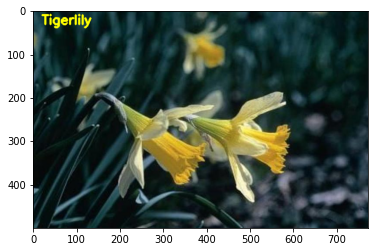

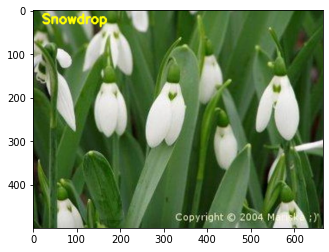

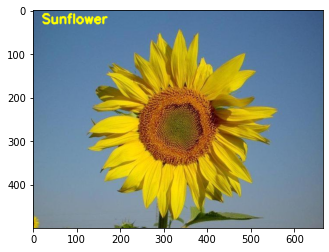

...

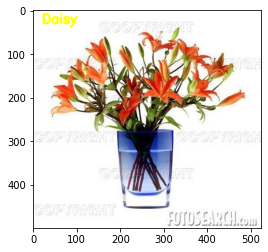

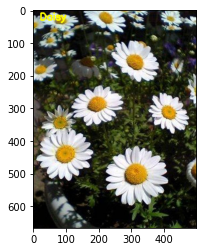

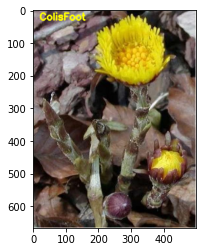

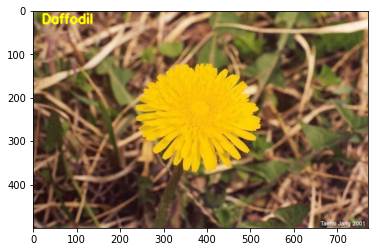

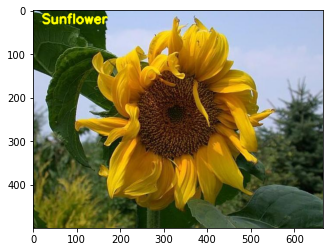

In [ ]:
### Testing the data for some random sample images 
import matplotlib.pyplot as plt

# create the model - MLP
clf  = MLPClassifier(solver = 'sgd', random_state = seed,  max_iter=3000)

# fit the training data to the model
clf.fit(trainDataGlobal, trainLabelsGlobal)
global_test_features = []

test_images_paths = glob.glob(test_path + "/*.jpg")
# loop through the test images
for file in test_images_paths:
    # read the image
    image = cv2.imread(file)

    # resize the image
    image = cv2.resize(image, fixed_size)

    # Global Feature extraction
    fv_hu_moments = fd_hu_moments(image)
    fv_haralick   = fd_haralick(image)
    fv_histogram  = fd_histogram(image)

    # Concatenate global features
    global_feature = np.hstack([fv_histogram, fv_haralick, fv_hu_moments])
    global_test_features.append(global_feature)
    
# scale features in the rangce (0 to 1)  
scaler = MinMaxScaler(feature_range=(0, 1))
rescaled_features = scaler.fit_transform(global_test_features)

# predict label of test image
predictions =  clf.predict(rescaled_features)  
print(len(predictions))

predict_index = 0
i = 0

for file in test_images_paths:
    image = cv2.imread(file)
    # show predicted label on image
    cv2.putText(image, train_labels[predictions[predict_index]], (20,30), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0,255,255), 3)

    # show the output image
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.show()
    predict_index += 1